In [1]:
import os
import plotly.graph_objects as go
import pandas as pd
import numpy as np

In [8]:
import plotly.io as pio
dpi = 600
format = ".tif"
width = 3.0
height = 1.5
scale = 6
text_color = "black"

In [3]:
spikes = ["SPWT","Epsl","Zeta","Beta", "Alfa","Delt","Kapp","Gamm","Iota","Iot2","Eta1","Ihu1","Omi1","Omi5"]
community_algorithm = "Louvain"
communities_dir = "/Louvain"

spike_muts_variants = {'Wild Type': np.array([]),
                         'Epsilon': np.array([ 13, 152, 452, 614]),
                         'Zeta': np.array([ 484,  614, 1176]),
                         'Beta': np.array([ 80, 215, 246, 417, 484, 501, 614, 701]),
                         'Alpha': np.array([ 501,  570,  614,  681,  716,  982, 1118]),
                         'Delta': np.array([158, 452, 478, 614, 681, 950]),
                         'Kappa': np.array([ 154,  484,  614,  681, 1071]),
                         'Gamma': np.array([ 138,  190,  417,  484,  501,  614,  655, 1027]),
                         'Iota1': np.array([  5,  95, 253, 477, 614]),
                         'Iota2': np.array([  5,  95, 253, 484, 614]),
                         'Eta': np.array([ 52,  67, 484, 614, 677, 888]),
                         'Ihu': np.array([  96,  190,  210,  346,  394,  449,  490,  501,  614,  681,  859,
                                 936, 1191]),
                         'Omicron1': np.array([ 67,  95, 142, 212, 339, 371, 373, 375, 417, 440, 446, 477, 478,
                                484, 493, 496, 498, 501, 505, 547, 614, 655, 679, 681, 764, 796,
                                856, 954, 969, 981]),
                         'Omicron5': np.array([142, 213, 339, 371, 373, 375, 376, 405, 408, 417, 440, 452, 477,
                                478, 484, 486, 498, 501, 505, 614, 655, 679, 681, 764, 796, 954,
                                969])
}
     
map_name_pdb = {list(spike_muts_variants.keys())[i]: spike_name for i, spike_name in enumerate(spikes)}
centralities_supported = ["Data/EC", "Data/KC", "Data/DC", "Data/CC", "Data/BC"]
map_centralities_dict_names = {       
                                "Data/BC": "betweenness",
                                "Data/EC": "eigenvector_c",
                                "Data/KC": "katz_c",
                                "Data/DC": "degree_c",
                                "Data/CC": "closeness"
                                }

In [4]:
map_name_pdb

{'Wild Type': 'SPWT',
 'Epsilon': 'Epsl',
 'Zeta': 'Zeta',
 'Beta': 'Beta',
 'Alpha': 'Alfa',
 'Delta': 'Delt',
 'Kappa': 'Kapp',
 'Gamma': 'Gamm',
 'Iota1': 'Iota',
 'Iota2': 'Iot2',
 'Eta': 'Eta1',
 'Ihu': 'Ihu1',
 'Omicron1': 'Omi1',
 'Omicron5': 'Omi5'}

In [5]:
th_min = 4.0
th_max = 8.0

In [9]:
def dict_from_txt(file):
    
    import ast
    import glob

    for file in glob.glob(filename):
    
        with open(file) as f:
            data = f.read()
    
    d = ast.literal_eval(data)
    
    return d

In [10]:
def find_mutated(dictionary, mutations):
    
    data = {}
    resis = [int(key.split()[0][3:]) for key in dictionary.keys()]
    map_residues = {int(key.split()[0][3:]): key for key in dictionary.keys()}

    for mut in mutations:
        if mut in resis:
            resi = map_residues[mut]
            data[resi] = "Community {}".format(dictionary[resi])  
        else: 
            data[mut] = "UM"
    return data
    

In [11]:
def count_dict_values(dictionary):
    from collections import Counter
    return dict(Counter(dictionary.values()))

In [12]:
spike_names = ["SPWT","Epsl","Zeta","Beta", "Alfa","Delt","Kapp","Gamm","Iota","Iot2","Eta1","Ihu1","Omi1","Omi5"] 

In [13]:
communities_all = {}
mutated_all = {}
count_mutations_in_communities = {}
for i, (spike_name, mutations) in enumerate(spike_muts_variants.items()):
    spike_pdb = spike_names[i]
    filename = "Data\Louvain\{}_Communities_louvain_ncoms*.txt".format(spike_pdb)
    communities = dict_from_txt(filename)
    communities_all[spike_name] = communities
    mutated = find_mutated(communities, mutations)
    mutated_all[spike_name] = mutated 
    count_mutations_in_communities[spike_name] = count_dict_values(mutated)

In [11]:
count_mutations_in_communities

{'Wild Type': {},
 'Epsilon': {'UM': 1, 'Community 2': 1, 'Community 14': 1, 'Community 11': 1},
 'Zeta': {'Community 15': 1, 'Community 8': 1, 'UM': 1},
 'Beta': {'Community 3': 2,
  'Community 10': 2,
  'Community 6': 2,
  'Community 16': 1,
  'Community 4': 1},
 'Alpha': {'Community 15': 1,
  'Community 10': 1,
  'Community 11': 2,
  'Community 1': 1,
  'Community 13': 1,
  'Community 14': 1},
 'Delta': {'Community 4': 1,
  'Community 15': 2,
  'Community 8': 1,
  'Community 7': 1,
  'Community 3': 1},
 'Kappa': {'Community 3': 1,
  'Community 7': 1,
  'Community 9': 2,
  'Community 2': 1},
 'Gamma': {'Community 2': 2,
  'Community 15': 3,
  'Community 9': 2,
  'Community 3': 1},
 'Iota1': {'UM': 1, 'Community 4': 2, 'Community 13': 1, 'Community 10': 1},
 'Iota2': {'UM': 1, 'Community 4': 2, 'Community 13': 1, 'Community 14': 1},
 'Eta': {'Community 2': 2,
  'Community 13': 1,
  'Community 10': 2,
  'Community 0': 1},
 'Ihu': {'Community 1': 3,
  'Community 13': 1,
  'Community 15'

In [12]:
import pandas as pd 
columns = ["variant", "n°. communities", "n°. mutations", "mutations for each comminity"]
n = len(spikes)
values = np.zeros((n, 4), dtype="<U11111111")
for i, (variant, communities) in enumerate(communities_all.items()):
        values[i][0] = variant
        values[i][1] = len(list(np.unique(list(communities.values()))))
        values[i][2] = len(list(spike_muts_variants[variant]))
        values[i][3] = count_mutations_in_communities[variant]
values

array([['Wild Type', '19', '0', '{}'],
       ['Epsilon', '22', '4',
        "{'UM': 1, 'Community 2': 1, 'Community 14': 1, 'Community 11': 1}"],
       ['Zeta', '21', '3',
        "{'Community 15': 1, 'Community 8': 1, 'UM': 1}"],
       ['Beta', '19', '8',
        "{'Community 3': 2, 'Community 10': 2, 'Community 6': 2, 'Community 16': 1, 'Community 4': 1}"],
       ['Alpha', '21', '7',
        "{'Community 15': 1, 'Community 10': 1, 'Community 11': 2, 'Community 1': 1, 'Community 13': 1, 'Community 14': 1}"],
       ['Delta', '19', '6',
        "{'Community 4': 1, 'Community 15': 2, 'Community 8': 1, 'Community 7': 1, 'Community 3': 1}"],
       ['Kappa', '20', '5',
        "{'Community 3': 1, 'Community 7': 1, 'Community 9': 2, 'Community 2': 1}"],
       ['Gamma', '21', '8',
        "{'Community 2': 2, 'Community 15': 3, 'Community 9': 2, 'Community 3': 1}"],
       ['Iota1', '18', '5',
        "{'UM': 1, 'Community 4': 2, 'Community 13': 1, 'Community 10': 1}"],
       ['Iota2',

In [13]:
df = pd.DataFrame(values, columns=columns)
df = df.set_index("variant")
df

,n°. communities,n°. mutations,mutations for each comminity
variant,,,
Wild Type,19,0,{}
Epsilon,22,4,"{'UM': 1, 'Community 2': 1, 'Community 14': 1,..."
Zeta,21,3,"{'Community 15': 1, 'Community 8': 1, 'UM': 1}"
Beta,19,8,"{'Community 3': 2, 'Community 10': 2, 'Communi..."
Alpha,21,7,"{'Community 15': 1, 'Community 10': 1, 'Commun..."
Delta,19,6,"{'Community 4': 1, 'Community 15': 2, 'Communi..."
Kappa,20,5,"{'Community 3': 1, 'Community 7': 1, 'Communit..."
Gamma,21,8,"{'Community 2': 2, 'Community 15': 3, 'Communi..."
Iota1,18,5,"{'UM': 1, 'Community 4': 2, 'Community 13': 1,..."


In [16]:
df.to_csv("Data\communities_report.csv")

In [17]:
def get_community(communities_all, variant, num): 
    community = [key for key, value in communities_all[variant].items() if value == num]
    print("Community number {} for variant {}: {}".format(num, variant, community))
    return community

In [28]:
def plot_mutated_in_community(community, mutations):
    
    temp = {int(residue.split()[0][3:]):residue for residue in community}
    dict_ = {resi: (True if resi in mutations else False) for resi in temp.keys()}
    df = pd.DataFrame.from_dict(dict_, columns = ["mutated"], orient="index")
    mutations_in_community = [mut for mut in mutations if mut in temp]
    first_mutated = temp[sorted(mutations_in_community)[0]]
    all_not_mutated =  [residue for residue in community if residue not in mutations_in_community]
    all_not_mutated_resi =  [residue for residue in temp.keys() if residue not in mutations_in_community]
    first_not_mutated = all_not_mutated[0]
    df['y']= 1
    colors = ["red" if resi in mutations_in_community else "green" for resi in temp.keys()]
    df['color'] = colors
    fig = go.Figure()
    [fig.add_trace(go.Bar(x=[resi], y=[df.iloc[i]["y"]], marker_color=df.iloc[i]["color"], name = str(df.iloc[i]['mutated']), legendgroup=str(df.iloc[i]['mutated']), showlegend=True if resi in [first_mutated, first_not_mutated] else False, hovertemplate="<br>".join(["Residue {} mutated: {}".format(resi, df.iloc[i]['mutated'])]))) for i, resi in enumerate(community)]
    return fig   

Community number 13 for variant Omicron1: ['LEU296 B', 'THR307 B', 'GLU309 B', 'LYS310 B', 'GLY311 B', 'ILE312 B', 'TYR313 B', 'GLN314 B', 'THR315 B', 'SER316 B', 'ASN317 B', 'PHE318 B', 'ARG319 B', 'VAL320 B', 'SER591 B', 'PHE592 B', 'GLY593 B', 'GLY594 B', 'VAL595 B', 'SER596 B', 'VAL597 B', 'ILE598 B', 'THR599 B', 'PRO600 B', 'GLY601 B', 'THR602 B', 'ASN603 B', 'THR604 B', 'SER605 B', 'ASN606 B', 'GLN607 B', 'VAL608 B', 'ALA609 B', 'VAL610 B', 'LEU611 B', 'TYR612 B', 'GLN613 B', 'GLY614 B', 'VAL615 B', 'ASN616 B', 'CYX617 B', 'THR618 B', 'GLU619 B', 'VAL620 B', 'PRO621 B', 'VAL622 B', 'ALA623 B', 'ILE624 B', 'HIE625 B', 'ALA626 B', 'ASP627 B', 'GLN628 B', 'LEU629 B', 'THR630 B', 'PRO631 B', 'THR632 B', 'TRP633 B', 'ARG634 B', 'VAL635 B', 'TYR636 B', 'SER637 B', 'THR638 B', 'GLY639 B', 'SER640 B', 'ASN641 B', 'VAL642 B', 'PHE643 B', 'GLN644 B', 'THR645 B', 'ARG646 B', 'ALA647 B', 'GLY648 B', 'CYX649 B', 'LEU650 B', 'ILE651 B', 'GLY652 B', 'ALA653 B', 'GLU654 B', 'TYR655 B', 'VAL656 B

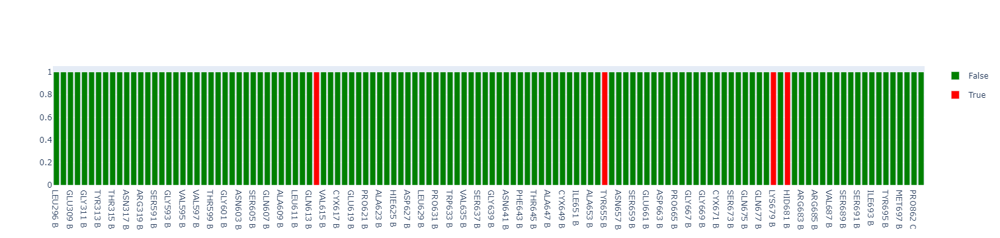

In [22]:
variant = "Omicron1"
num = 13
community = get_community(communities_all, variant, num)
mutations = spike_muts_variants[variant]
fig = plot_mutated_in_community(community, mutations)
fig.show()

In [19]:
def plot_mutated_and_communities(communities, mutations, variant):
    
    residues = [resi for resi in list(communities.keys())]
    n_resi = len(communities)
    comm_unique = list(np.unique(list(communities.values())))
    n_communities = len(comm_unique)
    fig = go.Figure()
    dcolorsc = ["green", "red"]
    data = []
    #print(comm_unique)
    for i, community in enumerate(comm_unique):
        #print(i, community)
        
        community_residues = [resi for resi, com in communities.items() if com == community]
        mutated = []
        for resi in residues:
            if resi in community_residues:
                if int(resi.split()[0][3:]) in mutations:
                    mutated.append(1)
                else:
                    mutated.append(0)
            else:
                mutated.append(np.nan)

        fig.add_trace(go.Heatmap(
                      z=mutated,
                      x=residues,
                      y=[i+1]*n_resi, 
                      colorscale = dcolorsc,
                      zmin=0,
                      zmax=1,
                      colorbar = dict(thickness=25, 
                                      tickvals=[0, 1], 
                                       ticktext = ["Not Mutated", "Mutated"])
                    )
               )
    fig.update_yaxes(tickmode='array', tickvals = [i+1 for i in range(len(comm_unique))], ticktext = ["Community {}".format(i+1) for i in range(len(comm_unique))])
    fig.update_layout(xaxis =  {'showgrid': False }, yaxis = { 'showgrid': False }, plot_bgcolor='rgba(0,0,0,0)', title = "{} variant mutations in Louvain communities".format(variant))
    return fig

In [20]:
for variant in spike_muts_variants.keys():
    communities = communities_all[variant]
    mutations = spike_muts_variants[variant]
    fig = plot_mutated_and_communities(communities, mutations, variant)
    fig.write_html("Figures\Mutations_In_Communities_html\{}_louvain.html".format(variant))
    #fig.write_image("Figures\Mutations_In_Communities\{}_louvain.png".format(variant))

In [21]:
import matplotlib.pyplot as plt
def color_map_clustering(clusters, variant, domain = None, domain_residues = None):
    """
    Clustering color map plot
    """
    n = len(clusters)
    cluster_map = np.zeros((n,n), dtype = int)
    labels_unique, counts = np.unique(clusters, return_counts=True)

    for i, label in enumerate(clusters):
        for j, label2 in enumerate(clusters):
            if ((cluster_map[i][j] == 0) and (label==label2)):
                cluster_map[i][j] = label+1

    plt.figure(figsize=(8,8))
    plt.matshow(cluster_map, vmin=0, vmax=max(clusters)+1, cmap='inferno', fignum=1)
    if domain_residues is not None:
        plt.xticks(np.arange(0, n, 50),  [domain_residues[i] for i in range(0, n, 50)], rotation=90)
        plt.yticks(np.arange(0, n, 50),  [domain_residues[i] for i in range(0, n, 50)])
    plt.legend(labels=labels_unique)
    if isinstance(domain, str):
        plt.savefig('Figures\Communities_map\{}_{}.png'.format(variant, domain))
    else:
        plt.savefig('Figures\Communities_map\{}.png'.format(variant))
    plt.show()

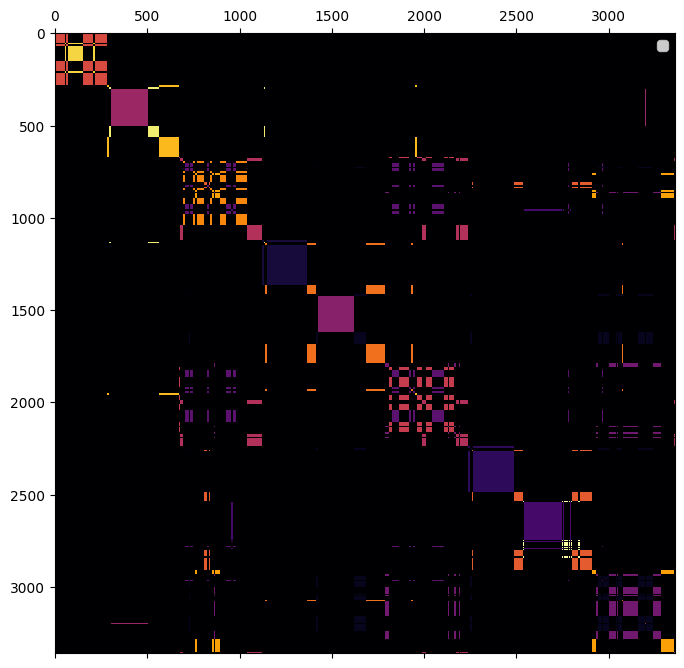

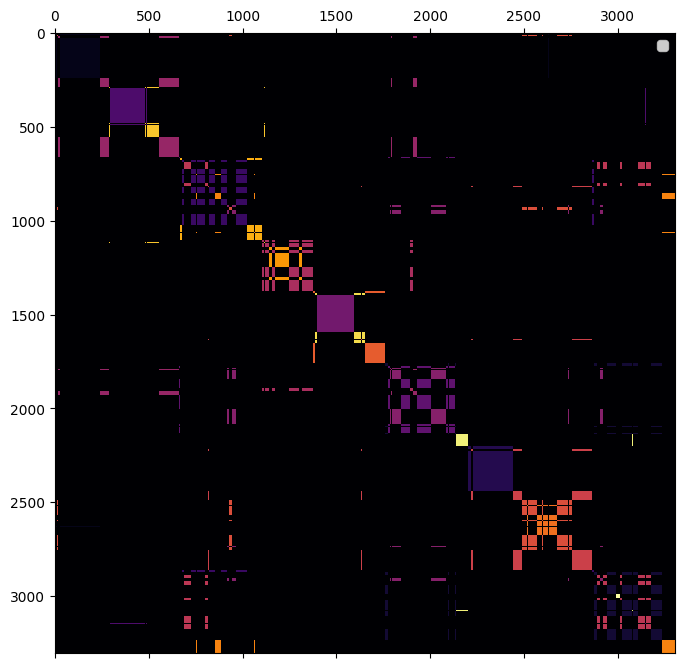

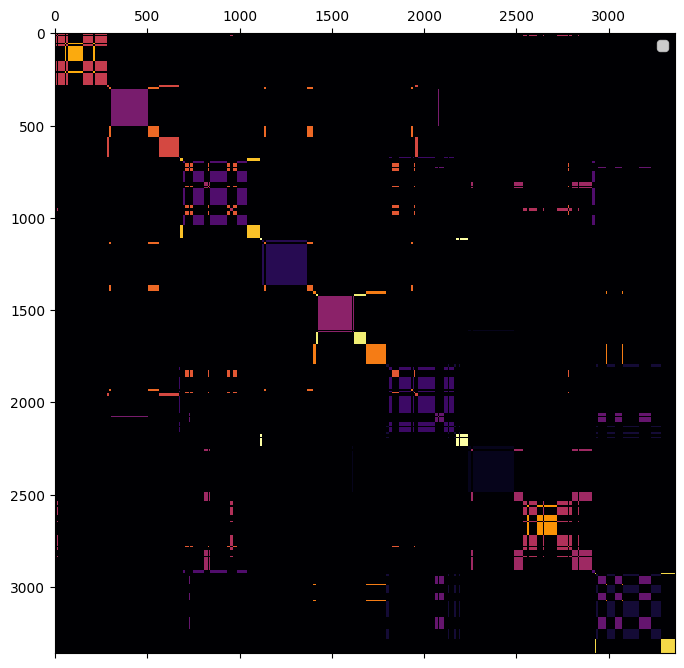

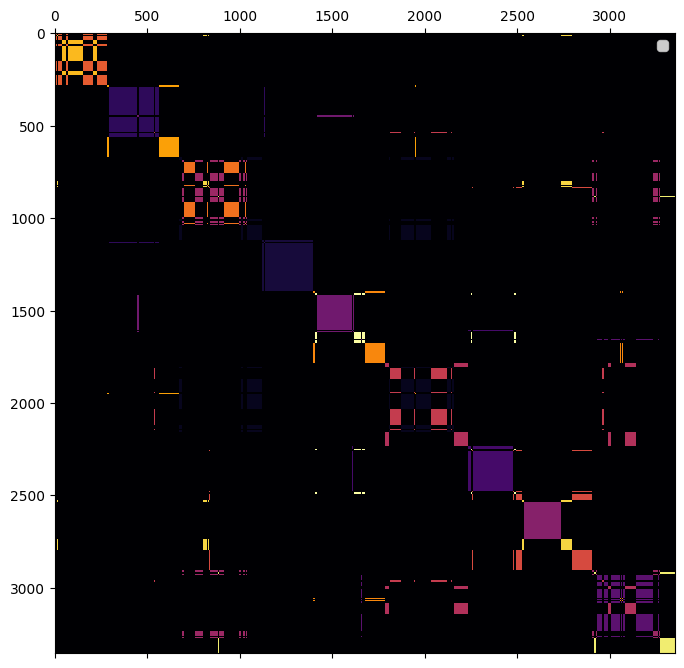

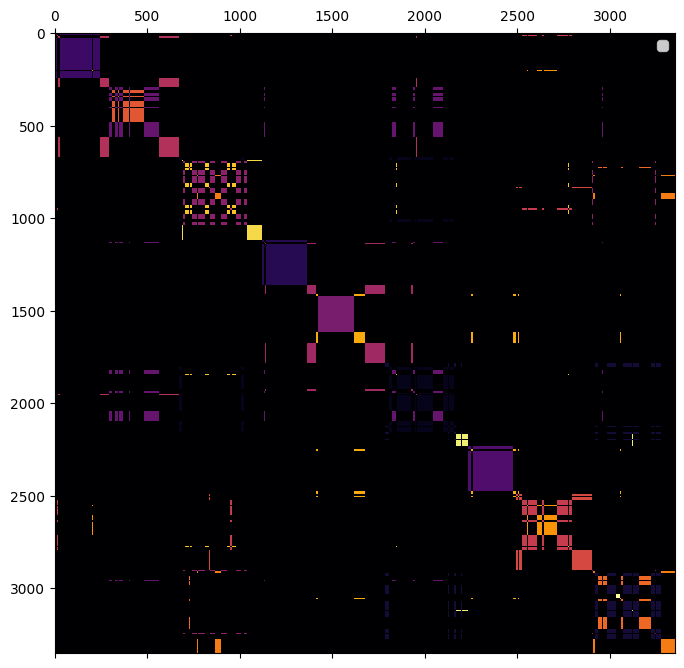

...

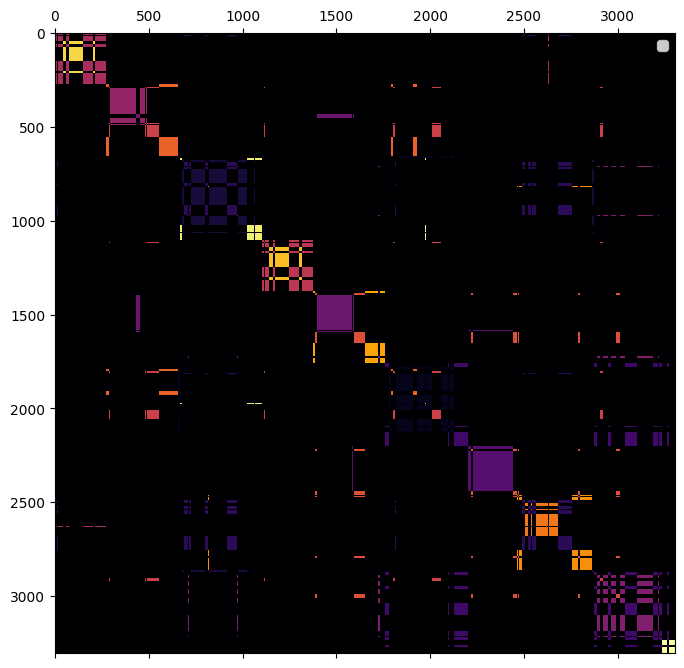

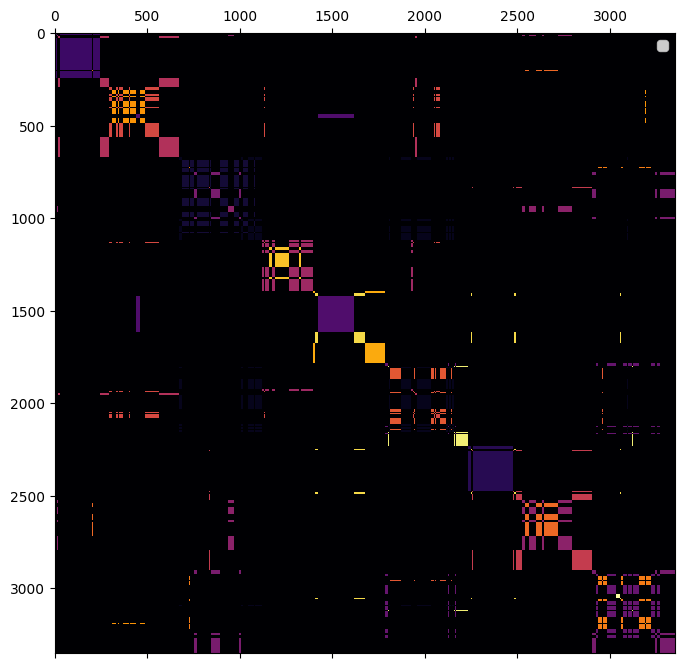

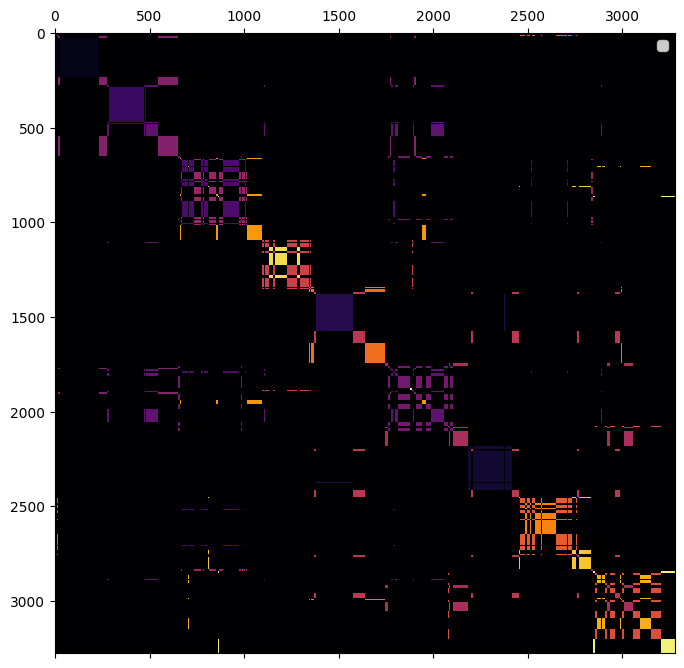

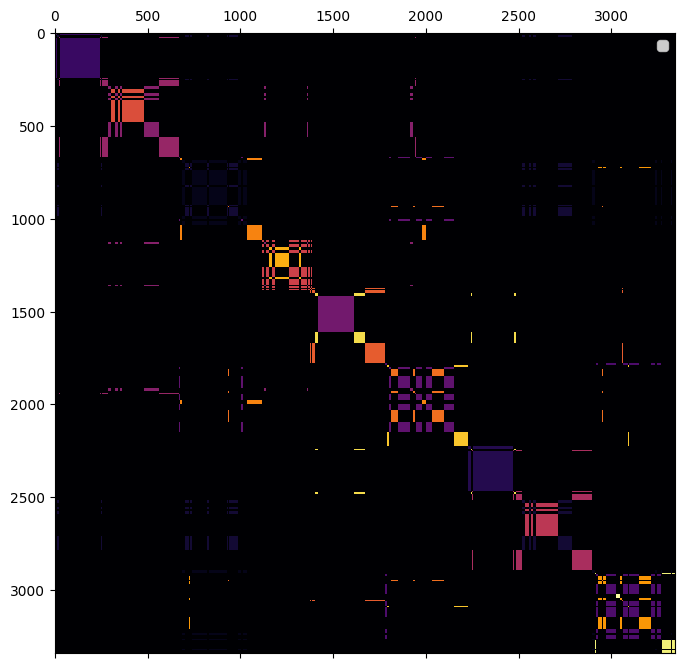

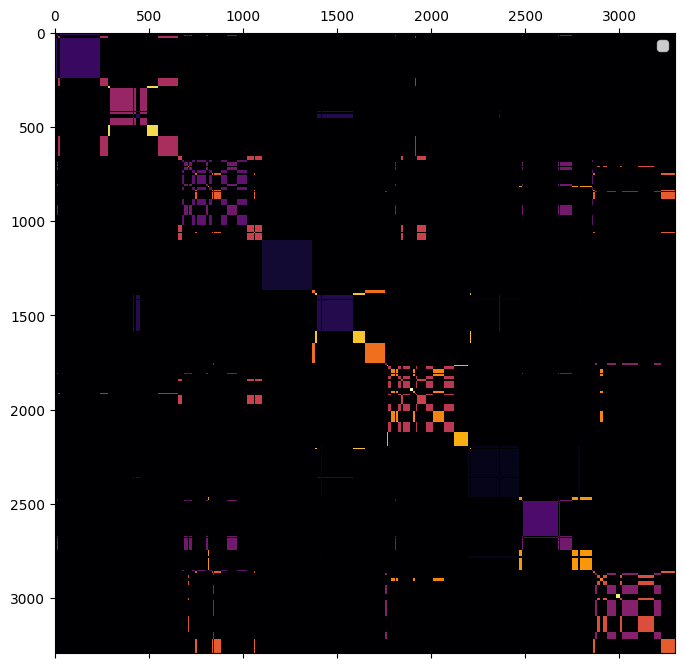

In [26]:
for variant, communities in communities_all.items():
    color_map_clustering(communities.values(), variant)

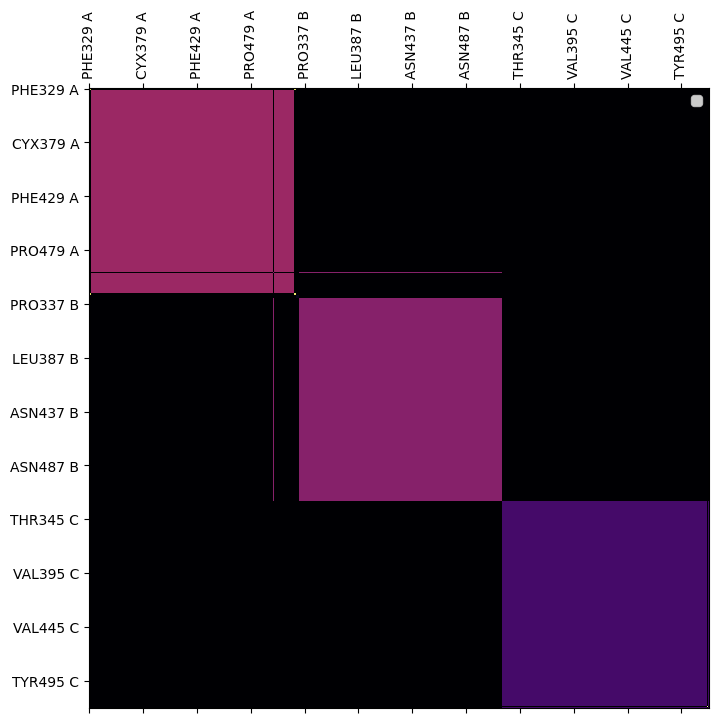

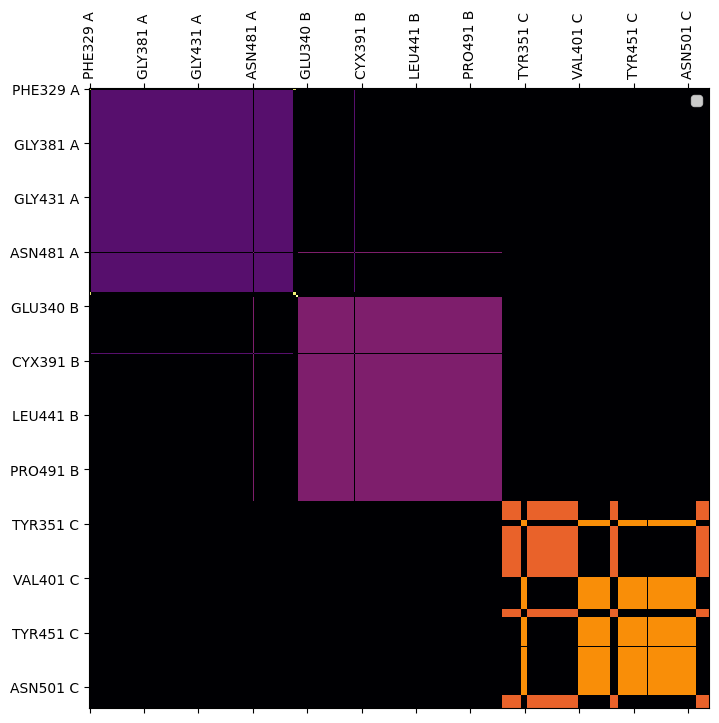

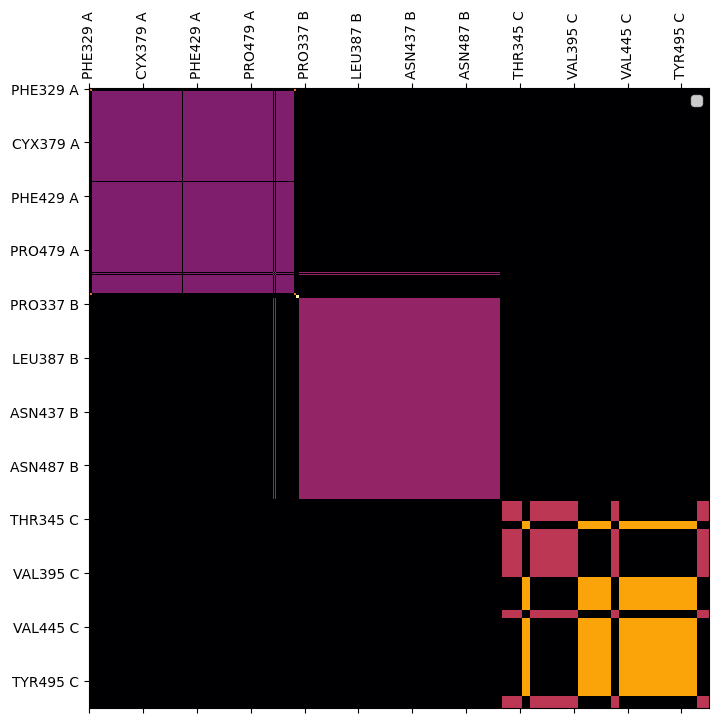

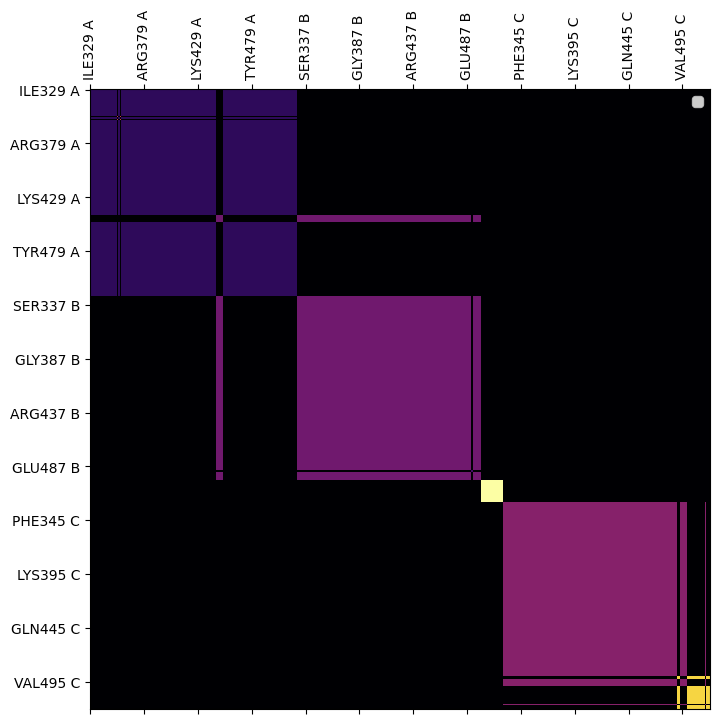

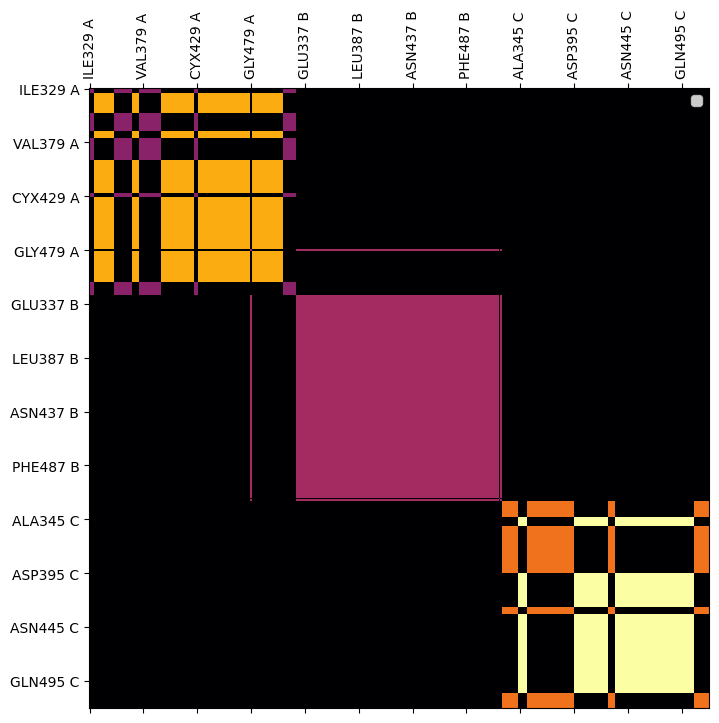

...

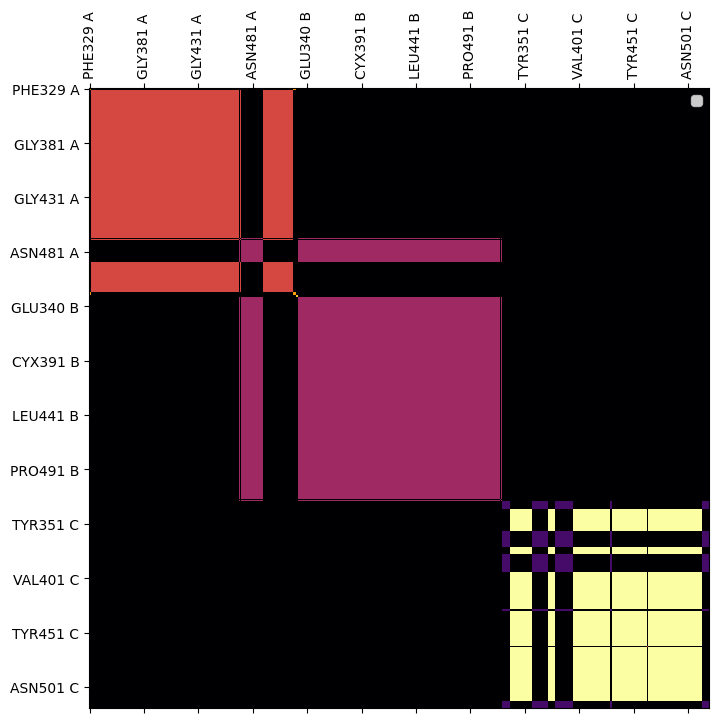

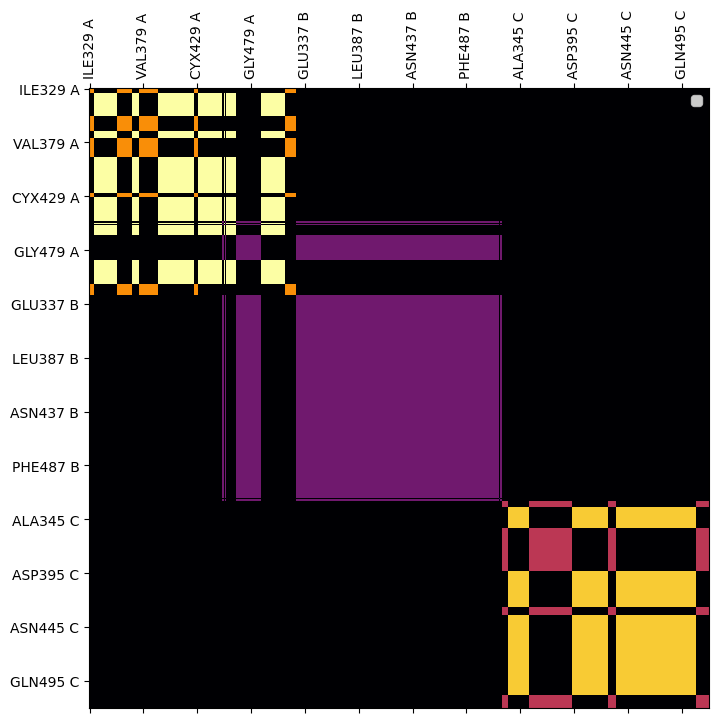

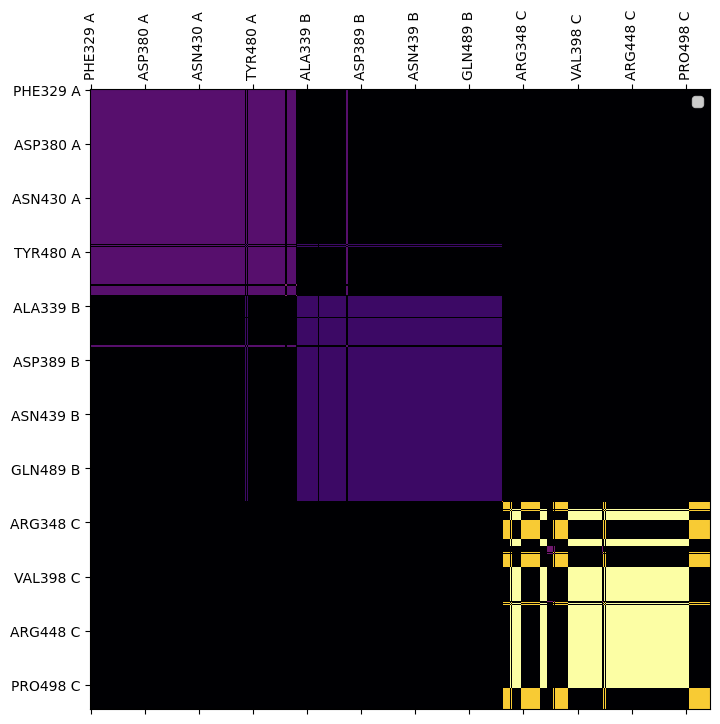

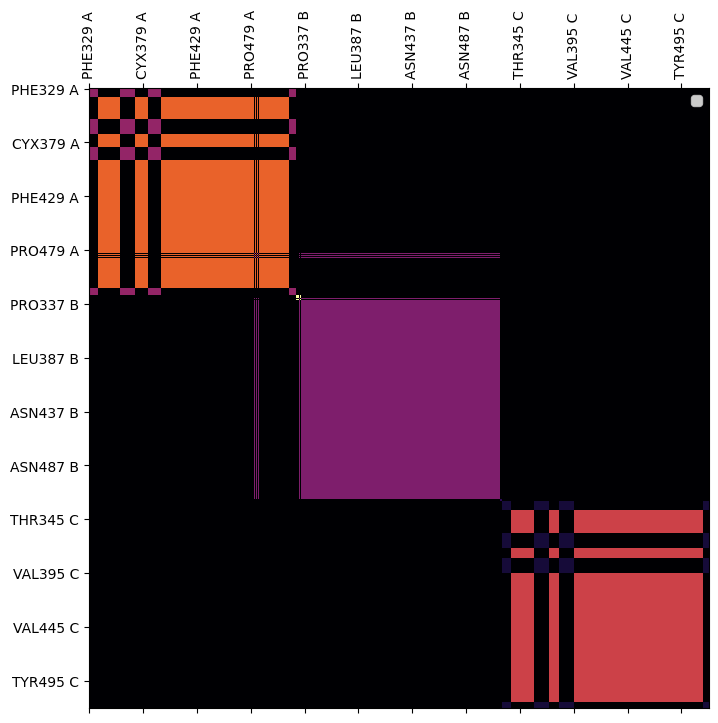

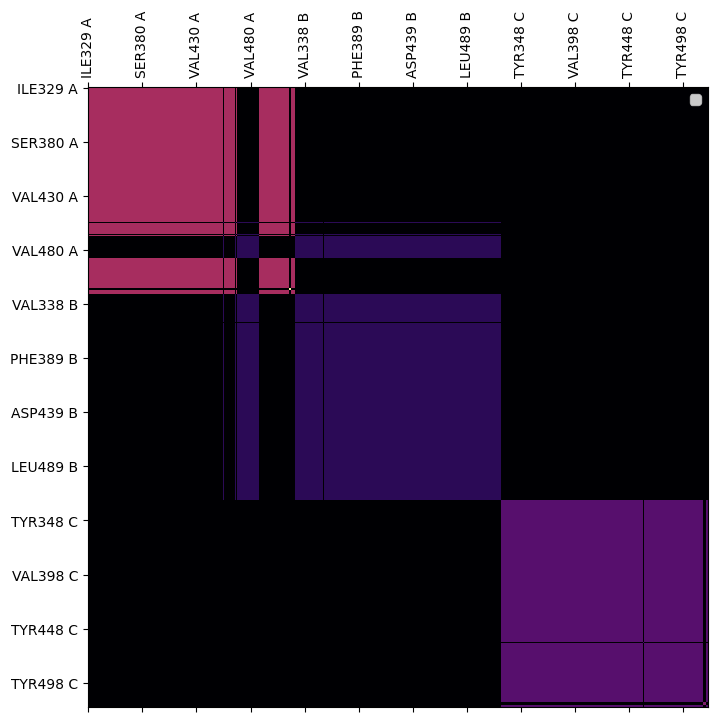

In [27]:
rbd = np.arange(329, 521, 1)
for variant, communities in communities_all.items():
    rbd_communities = {residue: value for residue, value in communities.items() if int(residue.split()[0][3:]) in rbd}
    color_map_clustering(rbd_communities.values(), variant, "rbd", list(rbd_communities.keys()))

In [22]:
def plot_centrality_hist(centrality_dict):
    #plotly
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=list(centrality_dict.keys()), y=list(centrality_dict.values()),
                marker_color='green',
                name='eigenvector centrality',
                fill='tozeroy'
        )
    )
    fig.update_layout(xaxis =  {'showgrid': False}, yaxis = { 'showgrid': False }, plot_bgcolor='rgba(0,0,0,0)')
    return fig    

In [29]:
for i, variant in enumerate(spike_muts_variants.keys()):
    for directory, centralityname in map_centralities_dict_names.items():
        spike_pdb = spike_names[i]
        filename = "{}/{}_{}.txt".format(directory, spike_pdb, centralityname)
        centrality_dict = dict_from_txt(filename)
        fig =  plot_centrality_hist(centrality_dict)
        fig.write_image("Figures\Centralities\{}\{}_{}_areaplot.png".format(directory.split("/")[1], centralityname, variant))
        fig.write_html("Figures\Centralities\{}\{}_{}_areaplot.html".format(directory.split("/")[1], centralityname, variant))

In [30]:
def plot_multiple_centrality_hist(variants, centrality_dicts):
        
    fig = go.Figure()
    colors = ['blue', 'brown', 'chocolate', 'coral', 'crimson', 'cyan', 'darkblue', 'darkcyan',
             'darkgray', 'darkgrey', 'darkgreen',
             'darkmagenta', 'darkolivegreen', 'darkred', 'darksalmon', 'darkseagreen',
                'darkorange', 'darkviolet', 'deeppink', 'dodgerblue', 'firebrick',
                'fuchsia', 'gold', 'gray', 'grey', 'green',
                'hotpink', 'lemonchiffon', 'lightblue', 'lime', 'limegreen',
                'linen', 'magenta', 'maroon', 'orangered',
                'palegreen', 'pink', 'purple', 'red', 'salmon', 'sienna', 'silver', 'skyblue',
                'turquoise', 'violet', 'black', 'yellow',
                'yellowgreen']
    for i, variant in enumerate(variants):
        centrality_dict = centrality_dicts[i]
        fig.add_trace(go.Scatter(x=list(centrality_dict.keys()), y=list(centrality_dict.values()),
                marker_color=colors[i],
                name=variant,
                fill='tozerox', 
                opacity = 0.5))
        
    # Overlay both histograms
    fig.update_layout(xaxis =  {'showgrid': False }, yaxis = { 'showgrid': False }, plot_bgcolor='rgba(0,0,0,0)')
    # Reduce opacity to see both histograms
    return fig

In [14]:
ec_all = {}
mutated_all = {}
for i, (spike_name, mutations) in enumerate(spike_muts_variants.items()):
    spike_pdb = spike_names[i]
    filename = "Data\EC\{}_eigenvector_c.txt".format(spike_pdb)
    ec = dict_from_txt(filename)
    ec_all[spike_name] = ec
    mutated = find_mutated(ec, mutations)
    mutated_all[spike_name] = mutated 
    
variants = ["Omicron1", "Omicron5", "Alpha"]
ec_variants = [ec_all[variant] for variant in variants]
#fig = plot_multiple_centrality_hist(variants, ec_variants) #remove unmodelled first TODO 
#fig.show()

In [23]:
def get_centrality_of_residues(residues, centrality_dict, centrality_name="Data\EC"):
    data = {}
    chains = ["A", "B", "C"]
    centrality_dict = {key[3:]: value for key, value in centrality_dict.items()}
    if isinstance(residues, int):
        residues = [residues]
    for residue in residues:
        if residue in [int(res.split()[0]) for res in centrality_dict.keys()]:
            for chain in chains:
                res = str(residue)+" "+chain
                data[res] = centrality_dict[res]
    return data

In [33]:
ec_omi = ec_all['Omicron1']

In [34]:
get_centrality_of_residues([501, 417], ec_omi, centrality_name="Data\EC")

{'501 A': 5.868104437603269e-07,
 '501 B': 2.081567056200006e-08,
 '501 C': 4.672865623708352e-06,
 '417 A': 8.905271547268786e-07,
 '417 B': 1.18323902039296e-08,
 '417 C': 5.621493952044103e-06}

In [53]:
def visualize_network(G, color_by = None, size_by = None, title = None, layout = "spring_layout", partition = None):
    """
  Layouts: [graphviz_layout, pydot_layout, bipartite_layout, circular_layout, kamada_kawai_layout, planar_layout, random_layout, rescale_layout,
            spring_layout, spectral_layout, spiral_layout, multipartite_layout, community_layout] 
  Size_by: "color_by", None, List or "node_attribute" in G.nodes(data=True)
    """
    
    colors = ['blue', 'brown', 'chocolate', 'coral', 'crimson', 'cyan', 'darkblue', 'darkcyan',
             'darkgray', 'darkgrey', 'darkgreen',
             'darkmagenta', 'darkolivegreen', 'darkred', 'darksalmon', 'darkseagreen',
                'darkorange', 'darkviolet', 'deeppink', 'dodgerblue', 'firebrick',
                'fuchsia', 'gold', 'gray', 'grey', 'green',
                'hotpink', 'lemonchiffon', 'lightblue', 'lime', 'limegreen',
                'linen', 'magenta', 'maroon', 'orangered',
                'palegreen', 'pink', 'purple', 'red', 'salmon', 'sienna', 'silver', 'skyblue',
                'turquoise', 'violet', 'black', 'yellow',
                'yellowgreen']
    
    if title is None:
        title = "Plotly Networkx visualization"
    if color_by is not None:
        colorscale = "Jet_r"
        if color_by not in set(G.nodes(data=True)[list(G.nodes.keys())[0]].keys()):
            raise Exception("Attribute Error: '{}' not found in nodes attributes".format(color_by))
    else:
        colorscale = "Blues"
        if size_by == "color_by":
            size_by = color_by
        #colorscale options
        #'Greys' | 'YlGnBu' | 'Greens' | 'YlOrRd' | 'Bluered' | 'RdBu' |
        #'Reds' | 'Blues' | 'Picnic' | 'Rainbow' | 'Portland' | 'Jet' |
        #'Hot' | 'Blackbody' | 'Earth' | 'Electric' | 'Viridis' |
        
    if partition is not None:
        layout == "community_layout"
    if layout is not None:
        if layout == "graphviz_layout":
            pos = nx.nx_pydot.graphviz_layout(G)
        elif layout == "pydot_layout":
            pos = nx.nx_pydot.pydot_layout(G)
        elif layout == "bipartite_layout":
            top = nx.bipartite.sets(G)[0]
            pos = nx.bipartite_layout(G, top)
        elif layout == "circular_layout":
            pos = nx.circular_layout(G)
        elif layout == "kamada_kawai_layout":
            pos = nx.kamada_kawai_layout(G)
        elif layout == "planar_layout":
            pos = nx.planar_layout(G)
        elif layout == "random_layout":
            pos = nx.random_layout(G)
        elif layout == "rescale_layout":
            pos = nx.rescale_layout(G)
        elif layout == "spring_layout":
            pos = nx.spring_layout(G)
        elif layout == "spectral_layout":
            pos = nx.spectral_layout(G)
        elif layout == "spiral_layout":
            pos = nx.spiral_layout(G)
        elif layout == "multipartite_layout":
            pos = nx.multipartite_layout(G)
        elif layout == "community_layout":
            if partition is not None:
                pos = community_layout(G, partition)
                colorscale = "Rainbow"
        elif isinstance(layout, dict):
            pos = layout
    
    
    if size_by is None:
        nx.set_node_attributes(G, pos, "pos")
      
    if color_by is not None:
        if partition is None:
            showscale = True 
        else:
            showscale = False
    else:
        showscale = False
    
    if partition is None:
        
        node_color = []
        node_size = []
        for node, attributes in G.nodes(data=True):
            if color_by is not None:
                value = attributes[color_by]
            else: 
                value = 0
            node_color.append(value)
            if size_by is not None:
                size = value*200
                if size < 6:
                    size = 6
                node_size.append(size)
            else:
                node_size.append(8)
            #node_trace.marker.color = node_color
        if size_by is not None:
            idx = np.argsort(np.array(node_color))
            nodes = list(G.nodes())
            nodes = np.array(nodes)[idx]
            H = nx.Graph()
            H.add_nodes_from(np.array(G.nodes(data=True))[idx])
            H.add_edges_from(G.edges(data=True))
            G = H
            node_color = np.array(node_color)[idx]
            node_size = np.array(node_size)[idx]
            pos = {list(pos.keys())[i]: list(pos.values())[i] for i in idx}
            nx.set_node_attributes(G, pos, "pos")
        nodes_text = []
        for node, attributes in G.nodes(data=True):
            node_text = "Node: {}\n\n".format(node)
            for attribute_name, value in dict(attributes).items():
                node_text += "{}: {}\n".format(attribute_name, value)
            nodes_text.append(node_text)
        if size_by is not None:
            nodes_text = np.array(nodes_text)[idx]
            line_width = 1
        else:
            line_width = 2
        node_x = []
        node_y = [] 
        for node in G.nodes():
            x, y = G.nodes[node]['pos']
            node_x.append(x)
            node_y.append(y)
        node_trace = go.Scatter(
            x=node_x, y=node_y,
            mode='markers',
            hoverinfo="name+text",
            marker = dict(
              showscale=showscale,
              colorscale=colorscale,
              reversescale=True,
              color=[],
              size=8,
              line_width=line_width,
              line_color="black",
              colorbar=dict(
                thickness=40,
                title=color_by,
                xanchor='left',
                titleside='right',
                tickfont_size=18 
              ),
            )
          )

        node_trace.marker.size = node_size
        node_trace.marker.color = node_color        
        node_trace.text = nodes_text
        
        
        
        edge_x = []
        edge_y = []
        edge_text = []
        for edge in G.edges():
            x0, y0 = G.nodes[edge[0]]['pos']
            x1, y1 = G.nodes[edge[1]]['pos']
            edge_x.append(x0)
            edge_x.append(x1)
            edge_x.append(None)
            edge_y.append(y0)
            edge_y.append(y1)
            edge_y.append(None)
            edge_text.append("Edge {} - {}".format(edge[0], edge[1]))
        if size_by is not None:
            edge_linewidth = 0.1
        else:
            edge_linewidth = 0.25
        edge_trace = go.Scatter(
            x=edge_x, y=edge_y,
            line=dict(width=edge_linewidth, color='black'),
            hoverinfo='text',
            name = "edges",
            text=edge_text,
            mode='lines'
        )

        
        fig = go.Figure(data=[edge_trace, node_trace],
                  layout=go.Layout(
                  title=title,
                  titlefont_size=28,
                  titlefont_color="black",
                  showlegend=False,
                  hovermode='closest',
                  #margin=dict(b=20,l=5,r=5,t=40),
                  xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                  yaxis=dict(showgrid=False, zeroline=False, showticklabels=False), 
                  template="plotly_white"
                  ),
        )
        
    
    else:
        fig = go.Figure(layout=go.Layout(
                  title=title,
                  titlefont_size=28,
                  titlefont_color="black",
                  showlegend=False,
                  hovermode='closest',
                  #margin=dict(b=20,l=5,r=5,t=40),
                  xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                  yaxis=dict(showgrid=False, zeroline=False, showticklabels=False), 
                  template="plotly_white"
            )
        )
        
        edge_x = []
        edge_y = []
        edge_text = []
        for edge in G.edges():
            x0, y0 = G.nodes[edge[0]]['pos']
            x1, y1 = G.nodes[edge[1]]['pos']
            edge_x.append(x0)
            edge_x.append(x1)
            edge_x.append(None)
            edge_y.append(y0)
            edge_y.append(y1)
            edge_y.append(None)
            edge_text.append("Edge {} - {}".format(edge[0], edge[1]))
        if size_by is not None:
            edge_linewidth = 0.1
        else:
            edge_linewidth = 0.25
        edge_trace = go.Scatter(
            x=edge_x, y=edge_y,
            line=dict(width=edge_linewidth, color='black'),
            hoverinfo='text',
            name = "edges",
            text=edge_text,
            mode='lines'
        )
        
        fig.add_trace(edge_trace)
        
        list_of_nodes_in_community_dict = {com: [node for node in list(partition.keys()) if partition[node] == com] for node, com in partition.items()}
        nodes_text = []
    
        for i, (com, nodes) in enumerate(list_of_nodes_in_community_dict.items()):
            
            color = colors[i]
            node_x = []
            node_y = []
            
            if size_by is not None:
                line_width = 1
            else:
                line_width = 2
            
            node_trace = go.Scatter(
                x=node_x, y=node_y,
                mode='markers',
                hoverinfo="name+text",
                marker = dict(
                  color=color,
                  size=8,
                  line_width=line_width
                  
               )
            )
            
            for node in nodes:
                x, y = G.nodes[node]['pos']
                node_x.append(x)
                node_y.append(y)
                node_text = "Node: {}\n\n".format(node)
                attributes = G.nodes(data=True)[node]
                for attribute_name, value in dict(attributes).items():
                    node_text += "{}: {}\n".format(attribute_name, value) 
                nodes_text.append(node_text)
            
            node_trace.legendgroup = "<b>"+str(com)+"</b>"
            node_trace.showlegend = True 
            node_trace.name = "<b>"+str(com)+"</b>"
            node_trace.x = node_x
            node_trace.y = node_y
            node_trace.text = nodes_text
            node_trace.marker.color = color
            if size_by is not None:
                size = value*200
                if size < 6:
                    size = 6
                node_trace.marker.size = node_size    
            else:
                size = 8
            fig.add_trace(node_trace)
        fig.update_layout(showlegend=True)
    return fig

In [46]:
def read_adj(pdb, th_min, th_max):
    adj = np.loadtxt("Data\Adj\{}_adj_mat_{}_{}.txt".format(pdb, th_min, th_max))
    return adj

In [47]:
#https://stackoverflow.com/questions/43541376/how-to-draw-communities-with-networkx
def community_layout(g, partition):
    """
    Compute the layout for a modular graph.


    Arguments:
    ----------
    g -- networkx.Graph or networkx.DiGraph instance
        graph to plot

    partition -- dict mapping int node -> int community
        graph partitions


    Returns:
    --------
    pos -- dict mapping int node -> (float x, float y)
        node positions

    """

    pos_communities = _position_communities(g, partition, scale=3.)

    pos_nodes = _position_nodes(g, partition, scale=1.)

    # combine positions
    pos = dict()
    for node in g.nodes():
        pos[node] = pos_communities[node] + pos_nodes[node]

    return pos

def _position_communities(g, partition, **kwargs):

    # create a weighted graph, in which each node corresponds to a community,
    # and each edge weight to the number of edges between communities
    between_community_edges = _find_between_community_edges(g, partition)

    communities = set(partition.values())
    hypergraph = nx.DiGraph()
    hypergraph.add_nodes_from(communities)
    for (ci, cj), edges in between_community_edges.items():
        hypergraph.add_edge(ci, cj, weight=len(edges))

    # find layout for communities
    pos_communities = nx.spring_layout(hypergraph, **kwargs)

    # set node positions to position of community
    pos = dict()
    for node, community in partition.items():
        pos[node] = pos_communities[community]

    return pos

def _find_between_community_edges(g, partition):

    edges = dict()

    for (ni, nj) in g.edges():
        ci = partition[ni]
        cj = partition[nj]

        if ci != cj:
            try:
                edges[(ci, cj)] += [(ni, nj)]
            except KeyError:
                edges[(ci, cj)] = [(ni, nj)]

    return edges

def _position_nodes(g, partition, **kwargs):
    """
    Positions nodes within communities.
    """

    communities = dict()
    for node, community in partition.items():
        try:
            communities[community] += [node]
        except KeyError:
            communities[community] = [node]

    pos = dict()
    for ci, nodes in communities.items():
        subgraph = g.subgraph(nodes)
        pos_subgraph = nx.spring_layout(subgraph, **kwargs)
        pos.update(pos_subgraph)

    return pos

In [48]:
import networkx as nx
variant = "Omicron1"
pdb = map_name_pdb[variant]
A = read_adj(pdb, th_min, th_max)
G = nx.from_numpy_array(A)
#pos = nx.spring_layout(G)
communities = communities_all[variant]
map_nodes = {i:resi for i, resi in enumerate(communities.keys())}
G = nx.relabel_nodes(G, map_nodes, copy=True)
nx.set_node_attributes(G, values=communities, name="louvain")
G.remove_nodes_from([node for node, attributes in G.nodes(data=True) if len(list(attributes.keys())) == 0])
pos =  community_layout(G, communities)

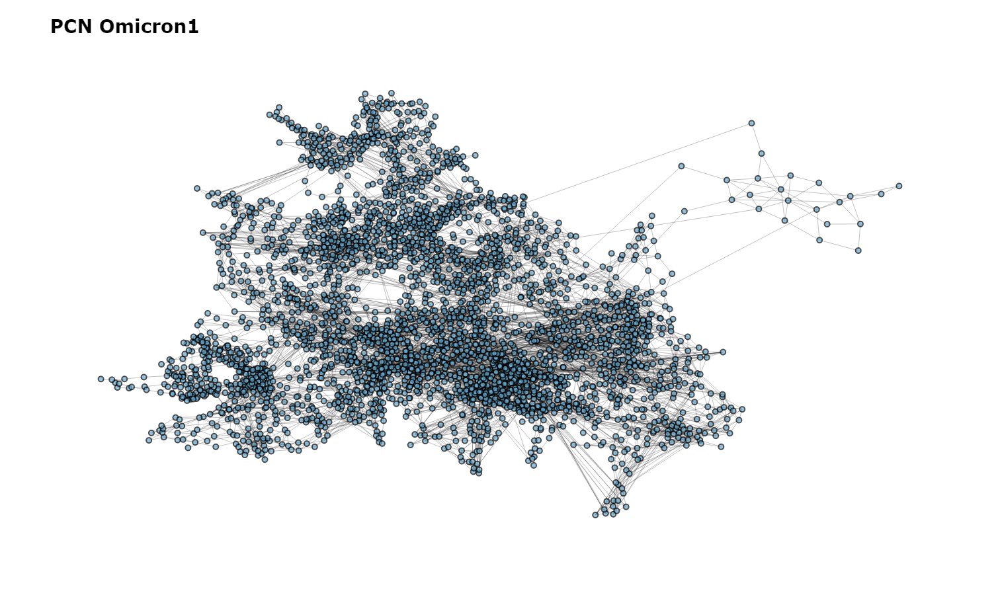

In [49]:
fig = visualize_network(G, color_by = None, size_by = None, title = "<b>PCN {}</b>".format(variant), layout = pos)
fig.update_layout(width=width*dpi, height=height*dpi)
fig.write_image("Figures/Centralities/omi1_network.png", engine = "orca", width=width*dpi, height=height*dpi, scale = scale)
fig.show()    

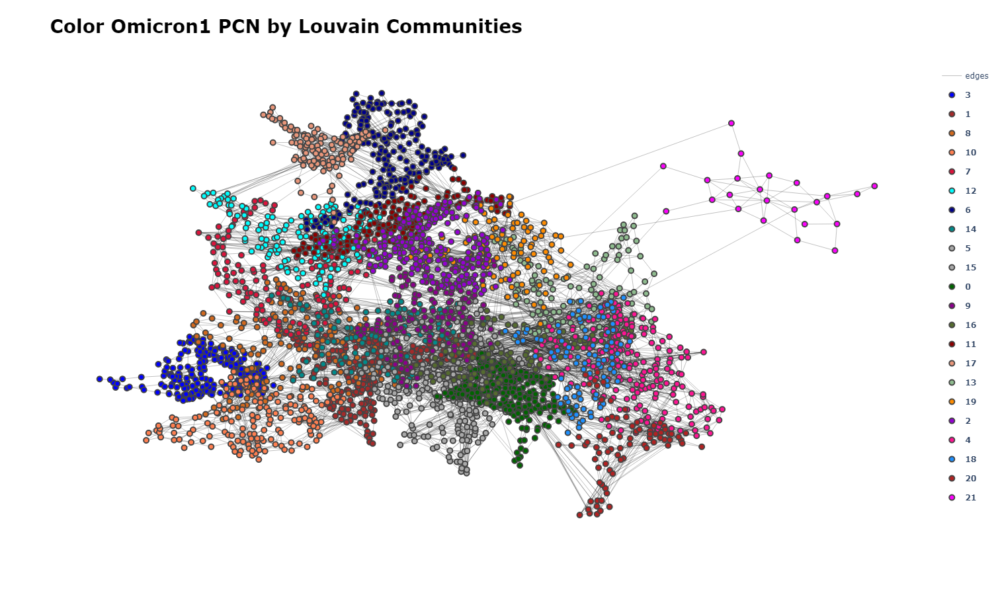

In [54]:
#G = nx.from_numpy_array(A)
fig = visualize_network(G, color_by = 'louvain', size_by = None, title = "<b>Color {} PCN by Louvain Communities</b>".format(variant), layout = pos, partition = communities)
fig.update_layout(width=width*dpi, height=height*dpi)
fig.write_image("Figures/Centralities/omi1_louvain_network.png", engine = "orca", width=width*dpi, height=height*dpi, scale = scale)
fig.show()   

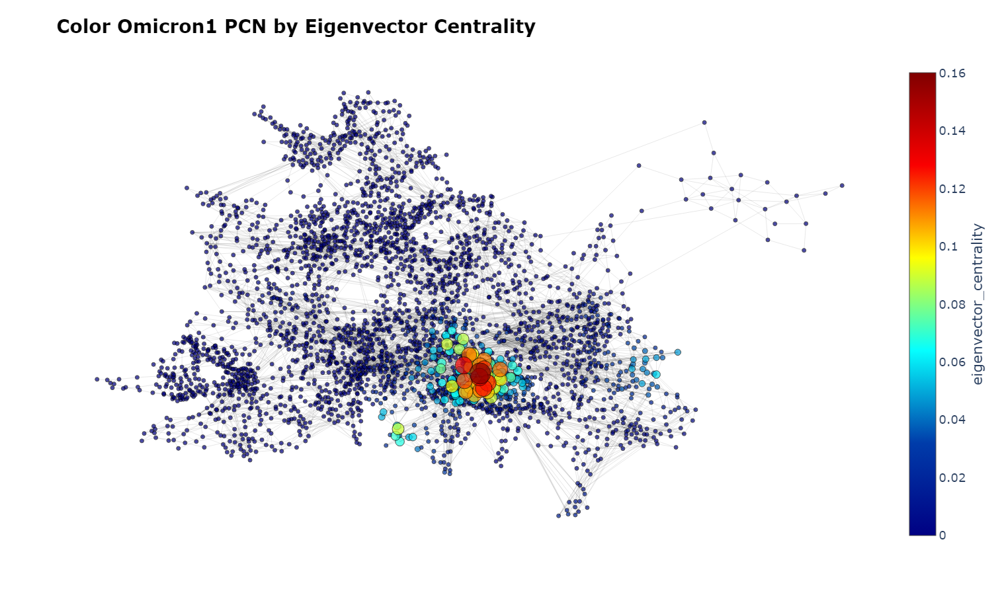

In [55]:
#G = nx.from_numpy_array(A)
variant = "Omicron1"
ec_var = ec_all[variant]
nx.set_node_attributes(G, values=ec_var, name="eigenvector_centrality")
G.remove_nodes_from([node for node, attributes in G.nodes(data=True) if len(list(attributes.keys())) == 0])
fig = visualize_network(G, color_by = 'eigenvector_centrality', size_by = "eigenvector_centrality", title = "<b> Color {} PCN by Eigenvector Centrality </b>".format(variant), layout = pos)
fig.update_layout(width=width*dpi, height=height*dpi)
fig.write_image("Figures/Centralities/omi1_ec_network.png", engine = "orca",  width=width*dpi, height=height*dpi, scale = scale)
fig.show()   

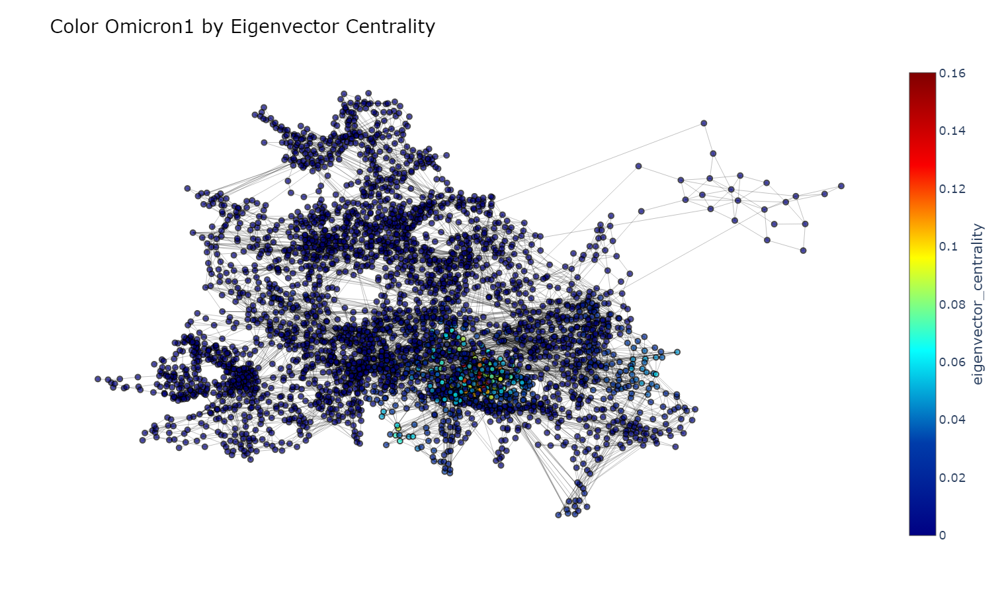

In [52]:
fig = visualize_network(G, color_by = 'eigenvector_centrality', size_by = None, title = "Color {} by Eigenvector Centrality".format(variant), layout = pos)
fig.update_layout(width=width*dpi, height=height*dpi)
fig.show()